## Painting to Photo

In [2]:
import fastai
from fastai.vision import *
from fastai.callbacks import *

from torchvision.models import vgg16_bn

In [2]:
URLs.PETS

'https://s3.amazonaws.com/fast-ai-imageclas/oxford-iiit-pet'

In [3]:
path = Path('/home/jupyter/.fastai/data/oxford-iiit-pet')

In [7]:
path.ls()

[PosixPath('/home/jupyter/.fastai/data/oxford-iiit-pet/small-96'),
 PosixPath('/home/jupyter/.fastai/data/oxford-iiit-pet/annotations'),
 PosixPath('/home/jupyter/.fastai/data/oxford-iiit-pet/images')]

In [4]:
# path = untar_data(URLs.PETS)
path_hr = path/'images'
# path_lr = path/'small-96'
# path_mr = path/'small-256'

In [5]:
path_paint = path/'painted_more'

In [7]:
tester = 'staffordshire_bull_terrier_86.jpg'

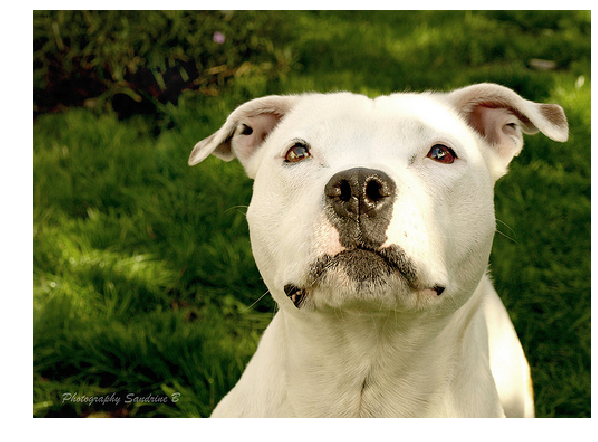

In [8]:
open_image(path_hr/tester).show(figsize=(10,10))

In [19]:
! convert '/home/jupyter/.fastai/data/oxford-iiit-pet/images/{tester}' -paint 7 '/home/jupyter/.fastai/data/oxford-iiit-pet/painted_more/{tester}'

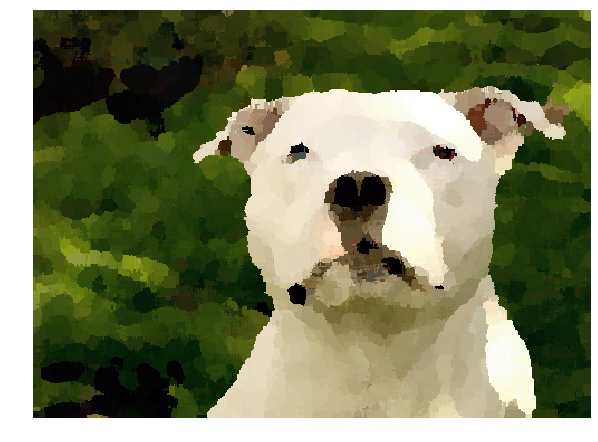

In [20]:
open_image(path_paint/tester).show(figsize=(10,10))

In [21]:
il = ImageItemList.from_folder(path_hr)

In [22]:
il.items[0]

PosixPath('/home/jupyter/.fastai/data/oxford-iiit-pet/images/pomeranian_27.jpg')

In [23]:
import subprocess

def paintify(fn,i):
    fn_path = Path(fn)
    dest = path_paint/fn_path.relative_to(path_hr)
    print("dest!!", dest)
    result = subprocess.call(["convert", fn,"-paint", "7", dest])
    print("result!! ", result)

In [88]:
# def resize_one(fn,i):
#     dest = path_lr/fn.relative_to(path_hr)
#     dest.parent.mkdir(parents=True, exist_ok=True)
#     img = PIL.Image.open(fn)
#     targ_sz = resize_to(img, 96, use_min=True)
#     img = img.resize(targ_sz, resample=PIL.Image.BILINEAR).convert('RGB')
#     img.save(dest, quality=60)

In [24]:
paintify('/home/jupyter/.fastai/data/oxford-iiit-pet/images/pomeranian_27.jpg', 0)

dest!! /home/jupyter/.fastai/data/oxford-iiit-pet/painted_more/pomeranian_27.jpg
result!!  0


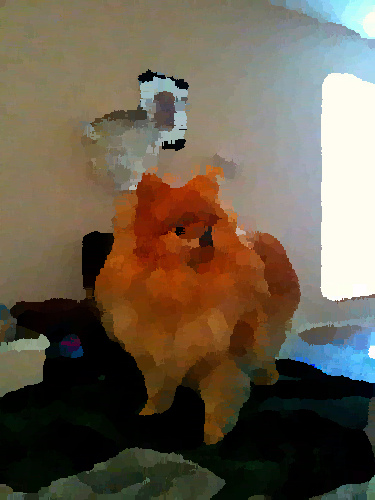

In [25]:
open_image('/home/jupyter/.fastai/data/oxford-iiit-pet/painted_more/pomeranian_27.jpg')

In [26]:
il.items[:1]

array([PosixPath('/home/jupyter/.fastai/data/oxford-iiit-pet/images/pomeranian_27.jpg')], dtype=object)

In [6]:
# to create paintified images, uncomment the next line when you run this the first time
# parallel(paintify, il.items)

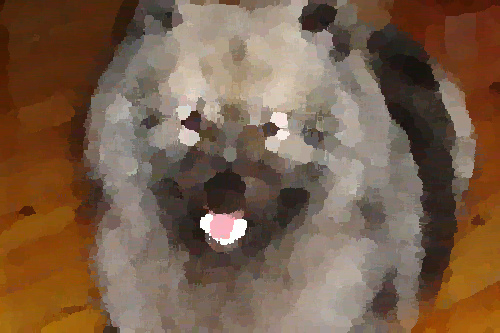

In [29]:
open_image('/home/jupyter/.fastai/data/oxford-iiit-pet/painted_more/keeshond_173.jpg')

In [7]:
bs,size=32,128
arch = models.resnet34

src = ImageImageList.from_folder(path_paint).random_split_by_pct(0.1, seed=42)

In [8]:
def get_data(bs,size):
    data = (src.label_from_func(lambda x: path_hr/x.name)
           .transform(get_transforms(max_zoom=2.), size=size, tfm_y=True)
           .databunch(bs=bs).normalize(imagenet_stats, do_y=True))

    data.c = 3
    return data

In [9]:
data = get_data(bs,size)

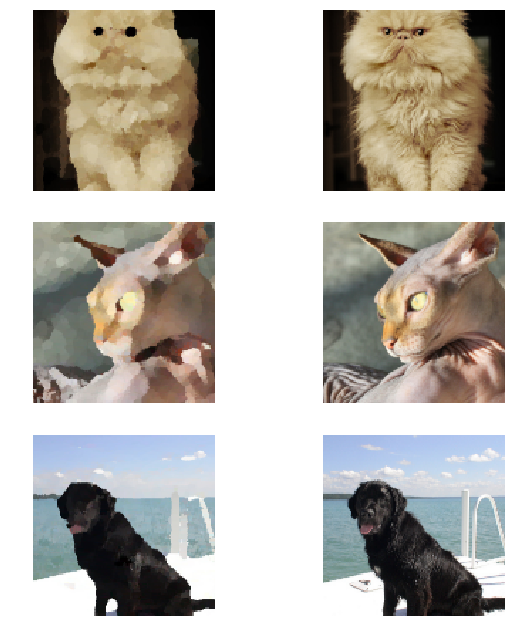

In [33]:
data.show_batch(ds_type=DatasetType.Valid, rows=3, figsize=(9,9))

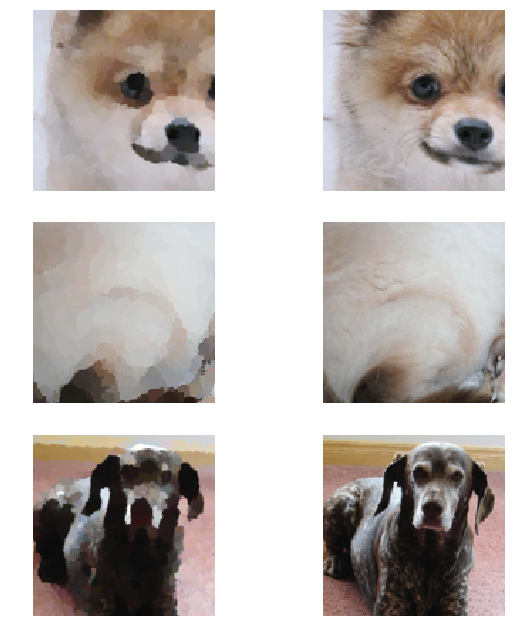

In [34]:
data.show_batch(ds_type=DatasetType.Train, rows=3, figsize=(9,9))

## Feature loss

In [10]:
t = data.valid_ds[0][1].data
t = torch.stack([t,t])

In [11]:
def gram_matrix(x):
    n,c,h,w = x.size()
    x = x.view(n, c, -1)
    return (x @ x.transpose(1,2))/(c*h*w)

In [12]:
gram_matrix(t)

tensor([[[0.1143, 0.1004, 0.0741],
         [0.1004, 0.0886, 0.0657],
         [0.0741, 0.0657, 0.0491]],

        [[0.1143, 0.1004, 0.0741],
         [0.1004, 0.0886, 0.0657],
         [0.0741, 0.0657, 0.0491]]])

In [13]:
base_loss = F.l1_loss

In [14]:
vgg_m = vgg16_bn(True).features.cuda().eval()
requires_grad(vgg_m, False)

In [15]:
blocks = [i-1 for i,o in enumerate(children(vgg_m)) if isinstance(o,nn.MaxPool2d)]
blocks, [vgg_m[i] for i in blocks]

([5, 12, 22, 32, 42],
 [ReLU(inplace), ReLU(inplace), ReLU(inplace), ReLU(inplace), ReLU(inplace)])

In [16]:
class FeatureLoss(nn.Module):
    def __init__(self, m_feat, layer_ids, layer_wgts):
        super().__init__()
        self.m_feat = m_feat
        self.loss_features = [self.m_feat[i] for i in layer_ids]
        self.hooks = hook_outputs(self.loss_features, detach=False)
        self.wgts = layer_wgts
        self.metric_names = ['pixel',] + [f'feat_{i}' for i in range(len(layer_ids))
              ] + [f'gram_{i}' for i in range(len(layer_ids))]

    def make_features(self, x, clone=False):
        self.m_feat(x)
        return [(o.clone() if clone else o) for o in self.hooks.stored]
    
    def forward(self, input, target):
        out_feat = self.make_features(target, clone=True)
        in_feat = self.make_features(input)
        self.feat_losses = [base_loss(input,target)]
        self.feat_losses += [base_loss(f_in, f_out)*w
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.feat_losses += [base_loss(gram_matrix(f_in), gram_matrix(f_out))*w**2 * 5e3
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.metrics = dict(zip(self.metric_names, self.feat_losses))
        return sum(self.feat_losses)
    
    def __del__(self): self.hooks.remove()

In [17]:
feat_loss = FeatureLoss(vgg_m, blocks[2:5], [5,15,2])

## Train

In [18]:
wd = 1e-3
learn = unet_learner(data, arch, wd=wd, loss_func=feat_loss, callback_fns=LossMetrics,
                     blur=True, norm_type=NormType.Weight)
gc.collect();

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


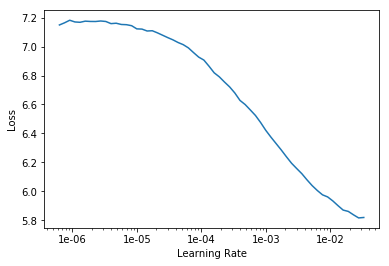

In [44]:
learn.lr_find()
learn.recorder.plot()

In [19]:
lr = 1e-3

In [20]:
def do_fit(save_name, lrs=slice(lr), pct_start=0.9):
    learn.fit_one_cycle(10, lrs, pct_start=pct_start)
    learn.save(save_name, return_path=True)
    learn.show_results(rows=1, imgsize=5)

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,4.302990,4.330142,0.197249,0.264959,0.372535,0.273165,0.605388,1.380958,1.235887
2,4.157023,4.229658,0.192762,0.262473,0.366107,0.267107,0.579500,1.345329,1.216380
3,4.106033,4.142993,0.214337,0.260942,0.359912,0.259922,0.563313,1.296420,1.188148
4,4.070373,4.042099,0.201449,0.259651,0.354450,0.251207,0.544259,1.283992,1.147091
5,4.030277,4.009408,0.192724,0.257213,0.350115,0.249123,0.545908,1.265956,1.148370
6,3.996390,3.946156,0.190762,0.256581,0.347617,0.247165,0.524270,1.240659,1.139102
7,3.917909,3.929783,0.192922,0.254405,0.344785,0.243474,0.532496,1.239853,1.121848
8,3.906430,3.845143,0.193659,0.253557,0.339905,0.238610,0.505186,1.213918,1.100308
9,3.880073,3.828411,0.191869,0.254347,0.339406,0.237777,0.499884,1.208555,1.096573
10,3.750515,3.695963,0.188383,0.250177,0.330047,0.227582,0.478779,1.171061,1.049935


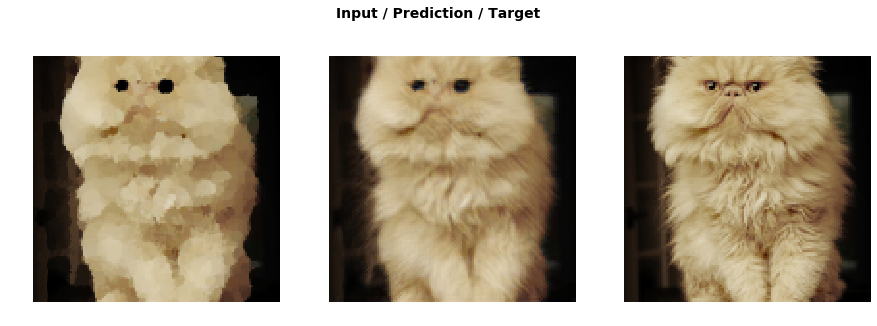

In [47]:
do_fit('painted_more_1a', slice(lr*10))

In [48]:
# learn.save('painted_more_1a-2', return_path=True)

PosixPath('/home/jupyter/.fastai/data/oxford-iiit-pet/painted_more/models/painted_more_1a-2.pth')

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,3.713474,3.686496,0.188757,0.250466,0.329447,0.226220,0.479168,1.168427,1.044013
2,3.713604,3.673039,0.189152,0.250260,0.328738,0.225179,0.475817,1.164873,1.039021
3,3.720504,3.671021,0.188854,0.249806,0.327622,0.225795,0.472013,1.165005,1.041926
4,3.726817,3.666601,0.190505,0.250321,0.327884,0.224912,0.470625,1.164886,1.037468
5,3.711394,3.684751,0.189804,0.250480,0.328662,0.225466,0.482772,1.168031,1.039536
6,3.730430,3.685843,0.190570,0.249677,0.328270,0.225381,0.481789,1.168659,1.041496
7,3.740346,3.693945,0.195263,0.251049,0.329626,0.226649,0.475114,1.169444,1.046801
8,3.729266,3.696407,0.194684,0.250886,0.328848,0.225904,0.486100,1.167954,1.042031
9,3.711050,3.662702,0.190795,0.249037,0.326674,0.223676,0.475162,1.161192,1.036166
10,3.632019,3.579635,0.188381,0.247340,0.321487,0.218039,0.457889,1.139292,1.007209


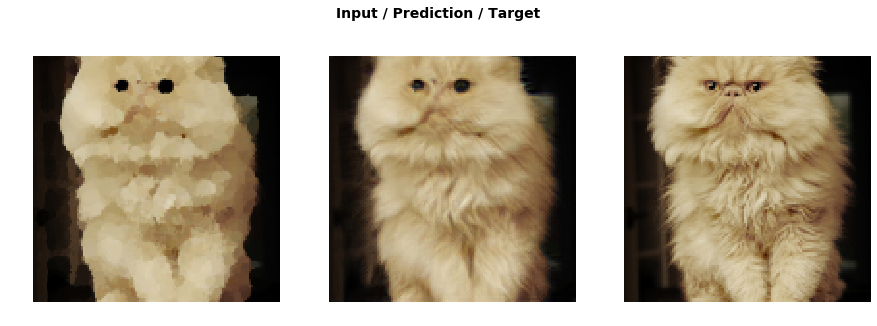

In [49]:
do_fit('painted_more_1a-2', slice(lr*10))

In [50]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,3.625029,3.571205,0.188043,0.246852,0.320716,0.217276,0.457429,1.136450,1.004441
2,3.609469,3.567811,0.187087,0.246401,0.320264,0.217163,0.456867,1.136001,1.004028
3,3.613084,3.570032,0.187174,0.246304,0.320113,0.217343,0.456677,1.134690,1.007731
4,3.609884,3.562891,0.186800,0.246018,0.319495,0.216973,0.455723,1.133898,1.003984
5,3.596870,3.562818,0.187524,0.246242,0.319360,0.217180,0.454460,1.133327,1.004725
6,3.606317,3.556387,0.186852,0.245482,0.318789,0.217023,0.452032,1.130704,1.005504
7,3.588213,3.561831,0.186658,0.245170,0.318599,0.217189,0.454821,1.131856,1.007538
8,3.610781,3.554633,0.186913,0.245860,0.318799,0.217028,0.451125,1.129035,1.005873
9,3.588846,3.550249,0.185354,0.244722,0.317888,0.216155,0.455720,1.126145,1.004266
10,3.560031,3.534181,0.186042,0.244614,0.317287,0.215073,0.450206,1.124129,0.996830


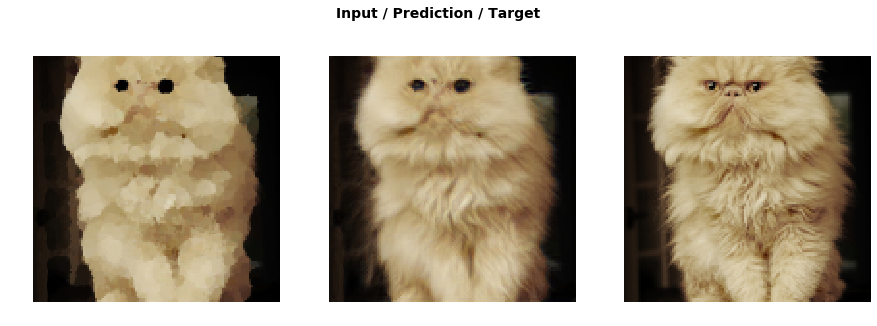

In [51]:
do_fit('painted_more_1b', slice(1e-5,1e-3))

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,3.572840,3.530664,0.185825,0.244598,0.316931,0.214759,0.450454,1.122978,0.995118
2,3.566838,3.526995,0.185330,0.244371,0.316807,0.214356,0.451063,1.121829,0.993239
3,3.562640,3.528562,0.185789,0.244399,0.316799,0.214400,0.451442,1.122184,0.993550
4,3.561280,3.525212,0.185585,0.244085,0.316514,0.214299,0.449212,1.121733,0.993785
5,3.562843,3.527370,0.186683,0.244341,0.316599,0.214634,0.448576,1.121283,0.995254
6,3.558024,3.528616,0.186126,0.244020,0.316516,0.214693,0.449204,1.122541,0.995516
7,3.567071,3.527737,0.185383,0.244536,0.316513,0.214480,0.451371,1.121751,0.993702
8,3.577875,3.530067,0.185989,0.244144,0.316366,0.214792,0.450904,1.123443,0.994427
9,3.551610,3.522636,0.185300,0.244166,0.315865,0.214634,0.448049,1.119653,0.994970
10,3.547183,3.508634,0.185318,0.243945,0.315470,0.213100,0.446794,1.116659,0.987348


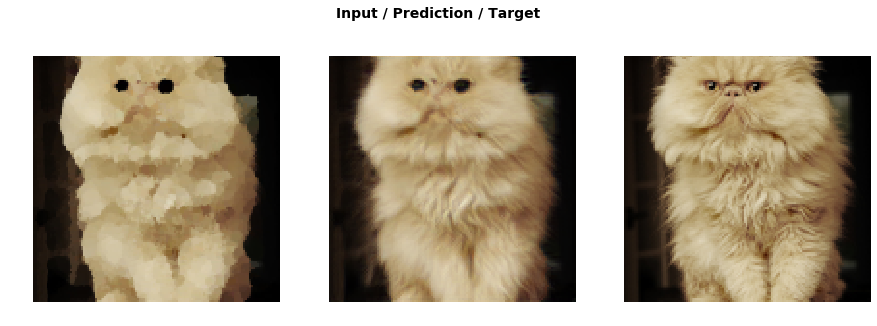

In [52]:
do_fit('painted_more_1b-2', slice(1e-5,1e-3))

In [53]:
data = get_data(bs//2,size*2)
learn.data = data
learn.freeze()

In [25]:
def do_fit_cycles(save_name, lrs=slice(lr), pct_start=0.9, cycles=10):
    learn.fit_one_cycle(cycles, lrs, pct_start=pct_start)
    learn.save(save_name, return_path=True)
    learn.show_results(rows=1, imgsize=5)

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,2.202663,2.187433,0.213936,0.271507,0.299125,0.158784,0.320097,0.554982,0.369001
2,2.192786,2.177486,0.214780,0.272104,0.298619,0.157813,0.314997,0.553649,0.365523
3,2.164397,2.165329,0.213693,0.271292,0.296820,0.156284,0.314712,0.549301,0.363226
4,2.159218,2.157066,0.214504,0.271534,0.295377,0.155479,0.312078,0.547263,0.360831
5,2.134897,2.140683,0.211934,0.270571,0.294460,0.154391,0.307729,0.543192,0.358406


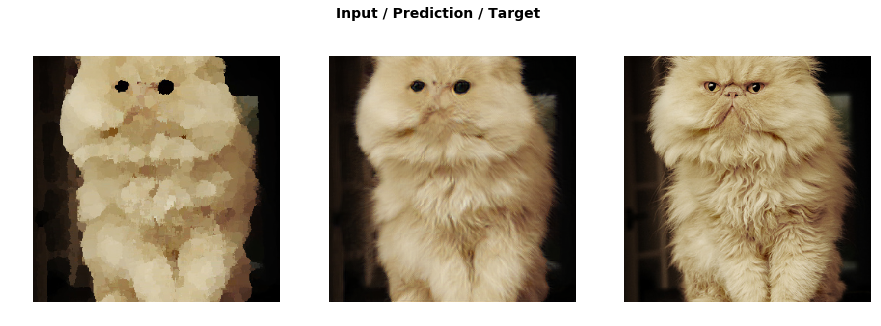

In [55]:
do_fit_cycles('painted_more_2a', cycles=5)

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,2.136661,2.138457,0.211957,0.270672,0.294347,0.154009,0.307159,0.542679,0.357633
2,2.134362,2.137386,0.212475,0.270537,0.293834,0.154090,0.307202,0.541915,0.357332
3,2.127208,2.134701,0.213189,0.269829,0.293285,0.153463,0.307093,0.541250,0.356593
4,2.142545,2.133226,0.213241,0.271260,0.293970,0.153544,0.303454,0.541888,0.355870
5,2.120228,2.121855,0.211499,0.269949,0.292677,0.152869,0.302265,0.538012,0.354583


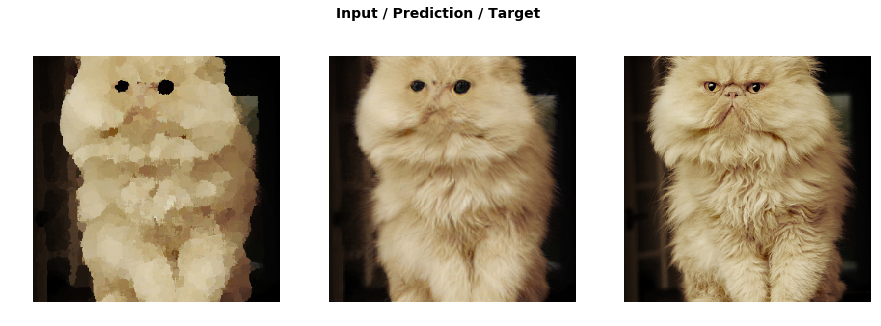

In [56]:
do_fit_cycles('painted_more_2a-2', cycles=5)

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,2.104970,2.119808,0.210916,0.269724,0.292193,0.152581,0.303190,0.537106,0.354097
2,2.117832,2.119262,0.211983,0.269903,0.292159,0.152317,0.302765,0.536523,0.353614
3,2.106183,2.121219,0.212077,0.269397,0.291873,0.152411,0.303016,0.538886,0.353558
4,2.107666,2.119657,0.211545,0.270198,0.292081,0.152279,0.301199,0.539173,0.353183
5,2.104945,2.106887,0.210894,0.269217,0.290890,0.151784,0.298655,0.533671,0.351776


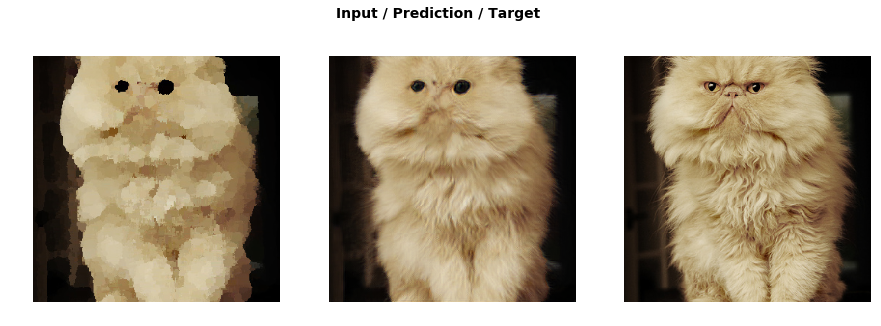

In [57]:
do_fit_cycles('painted_more_2a-3', cycles=5)

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,2.088175,2.106743,0.210277,0.268874,0.290750,0.151393,0.300634,0.533656,0.351159
2,2.101038,2.106477,0.212578,0.269539,0.291195,0.151494,0.297418,0.533171,0.351081
3,2.097594,2.106418,0.210947,0.269227,0.290540,0.151111,0.300016,0.533336,0.351241
4,2.101825,2.107207,0.212229,0.269016,0.291072,0.151251,0.298097,0.534730,0.350811
5,2.095796,2.096747,0.209461,0.268779,0.290071,0.150893,0.296975,0.530446,0.350121


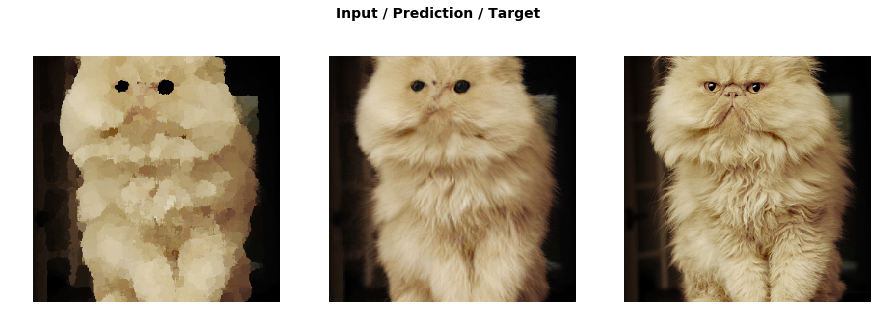

In [58]:
do_fit_cycles('painted_more_2a-4', cycles=5)

In [59]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,2.088440,2.094409,0.209894,0.269022,0.289982,0.150618,0.295511,0.530048,0.349335
2,2.081330,2.091782,0.209824,0.268778,0.289910,0.150364,0.294689,0.529242,0.348975
3,2.084975,2.090424,0.210566,0.269252,0.289692,0.150052,0.293873,0.529142,0.347847
4,2.068144,2.089570,0.209077,0.268290,0.289220,0.149872,0.296428,0.528684,0.348000
5,2.076961,2.088351,0.209498,0.268555,0.289352,0.149873,0.294874,0.528405,0.347793


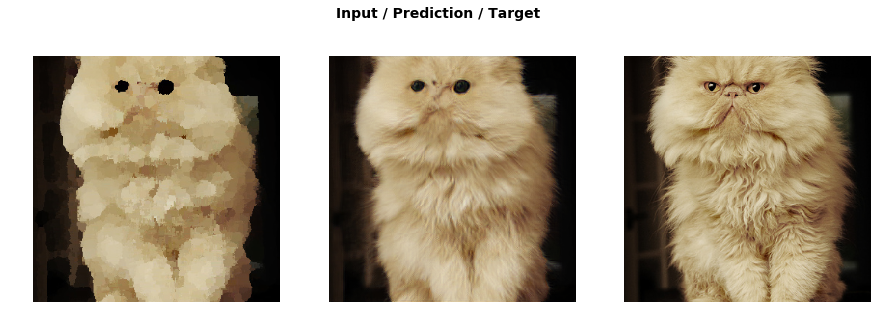

In [61]:
do_fit_cycles('painted_more_2b', slice(1e-6,1e-4), pct_start=0.3, cycles=5)

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,2.084877,2.088526,0.209812,0.268581,0.289393,0.149949,0.294628,0.528213,0.347950
2,2.078113,2.088076,0.209648,0.268392,0.289219,0.149764,0.295216,0.528181,0.347657
3,2.073625,2.085989,0.209432,0.268508,0.289236,0.149805,0.294334,0.527479,0.347197
4,2.081113,2.085563,0.210369,0.268513,0.289248,0.149787,0.293003,0.527444,0.347198
5,2.086797,2.085106,0.209245,0.268303,0.288961,0.149584,0.294599,0.527432,0.346983


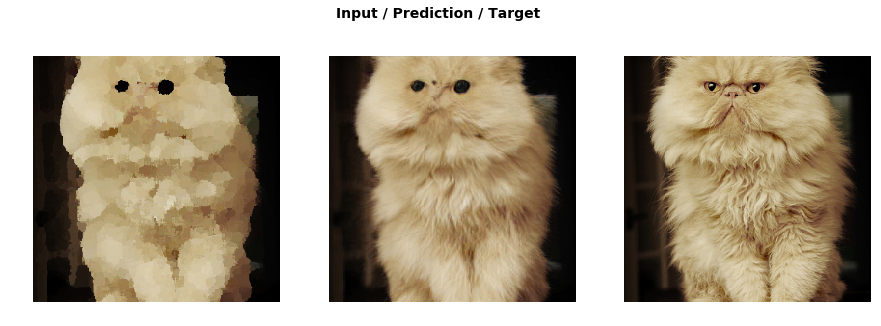

In [62]:
do_fit_cycles('painted_more_2b-2', slice(1e-6,1e-4), pct_start=0.3, cycles=5)

In [59]:
# learn.load('painted_more_2b');

In [22]:
data = get_data(bs//8,size*4)
learn.data = data
learn.freeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,1.485973,1.469511,0.212275,0.277123,0.270767,0.100302,0.214759,0.278440,0.115846
2,1.485795,1.465071,0.211003,0.274473,0.269043,0.099594,0.217245,0.278603,0.115110
3,1.474813,1.456950,0.208928,0.274726,0.268431,0.098302,0.215271,0.276924,0.114369
4,1.452995,1.446826,0.208841,0.275094,0.266564,0.098227,0.210174,0.274071,0.113853
5,1.436852,1.436251,0.204827,0.273581,0.265644,0.097340,0.209543,0.271925,0.113390


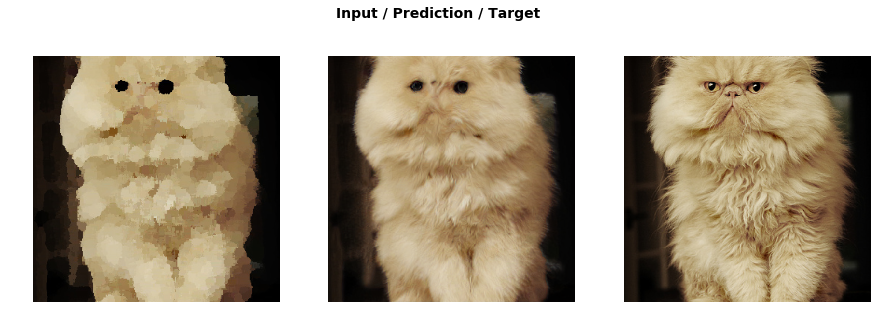

In [23]:
do_fit_cycles('painted_more_3a', cycles=5)

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,1.418818,1.438804,0.206682,0.273837,0.265882,0.098225,0.208468,0.272194,0.113516
2,1.446531,1.436921,0.206963,0.274545,0.265752,0.098449,0.206961,0.270834,0.113418
3,1.436132,1.437346,0.207407,0.274664,0.265037,0.097210,0.207782,0.271898,0.113349
4,1.437233,1.446054,0.208296,0.275262,0.266051,0.098027,0.210227,0.274673,0.113517
5,1.409541,1.421037,0.204495,0.272592,0.263701,0.096720,0.203832,0.267459,0.112238


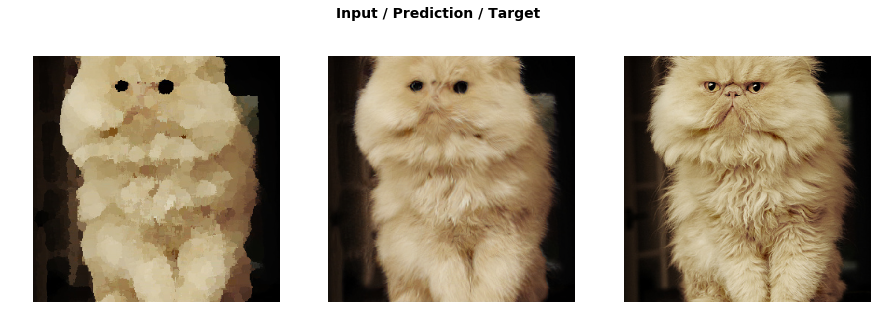

In [24]:
do_fit_cycles('painted_more_3a-2', cycles=5)

In [60]:
# learn.load('painted_more_3a-2');

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,1.409952,1.420660,0.203808,0.272085,0.263472,0.096818,0.204611,0.267596,0.112270
2,1.426600,1.417832,0.204711,0.273118,0.263570,0.096547,0.201903,0.266139,0.111844
3,1.400560,1.415938,0.203796,0.272634,0.263169,0.096595,0.202270,0.265761,0.111712
4,1.410372,1.415547,0.203974,0.272970,0.263469,0.096426,0.201089,0.266055,0.111564
5,1.414101,1.415012,0.203581,0.272232,0.262991,0.096547,0.202363,0.265668,0.111630


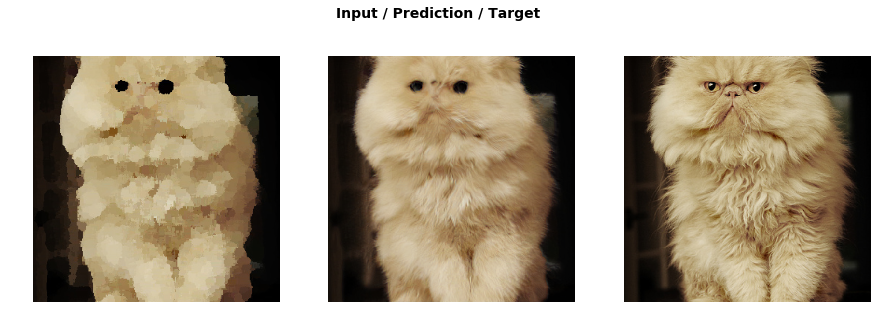

In [26]:
learn.unfreeze()
do_fit_cycles('painted_more_3b', slice(1e-6,1e-4), pct_start=0.3, cycles=5)

## Test

In [61]:
# data = get_data(bs//2,size*2*2*2)
# learn.data = data
# learn.load('painted_more_3b');

In [72]:
! convert '/home/jupyter/dog-oil-paintings/labrador-photo.jpg' -paint 7 '/home/jupyter/dog-oil-paintings/labrador-photo-turned-painting.jpg'

In [27]:
test_image = open_image('/home/jupyter/dog-oil-paintings/labrador-photo-turned-painting.jpg')

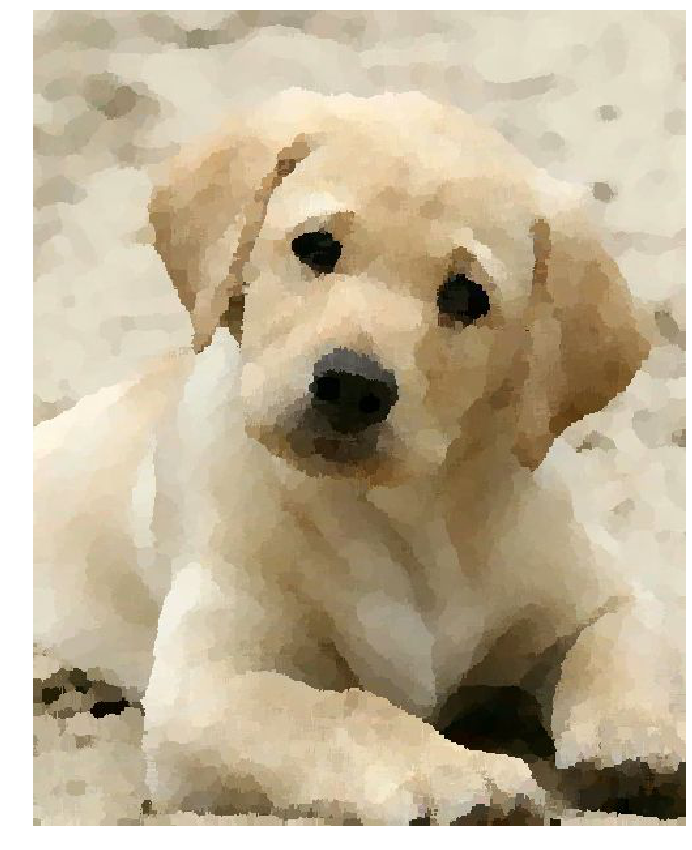

In [28]:
test_image.show(figsize=(18,15))

In [29]:
_,img_hr,b = learn.predict(test_image)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


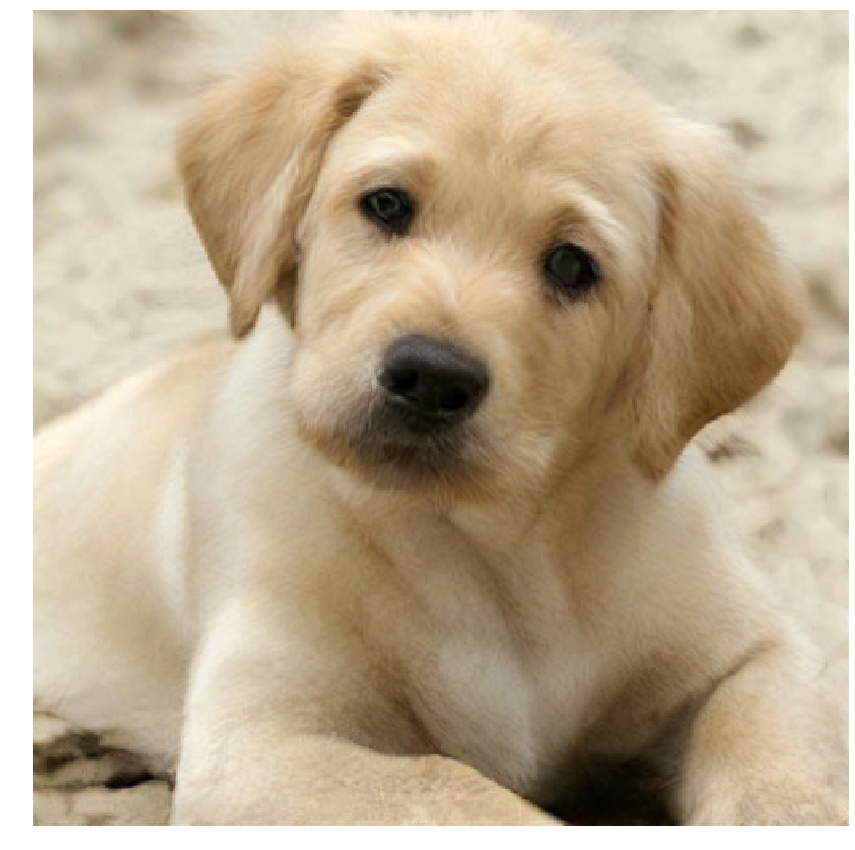

In [30]:
Image(img_hr).show(figsize=(18,15))

In [35]:
test_image = open_image('/home/jupyter/dog-oil-paintings/afremov.jpeg')

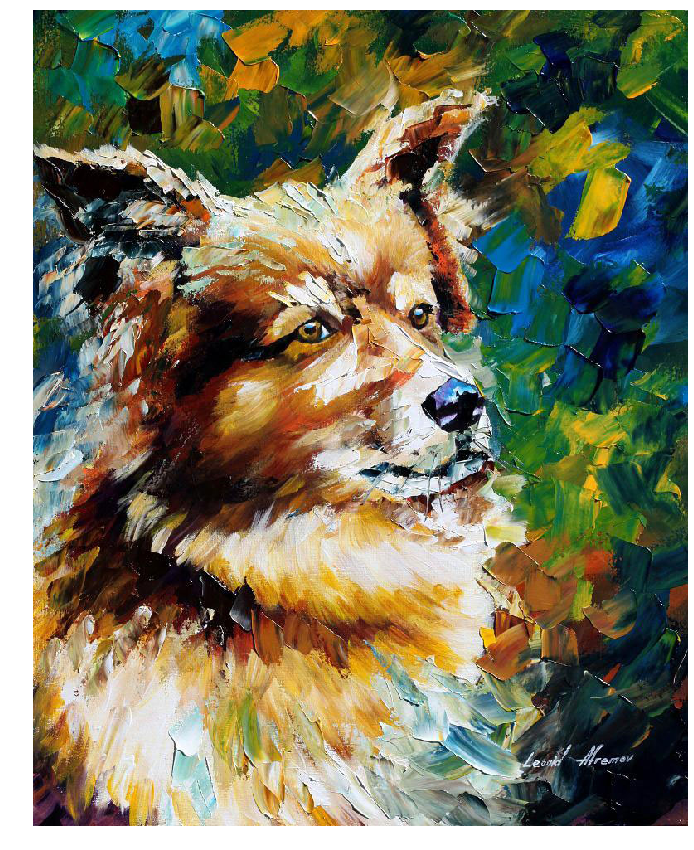

In [36]:
test_image.show(figsize=(18,15))

In [37]:
_,img_hr,b = learn.predict(test_image)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


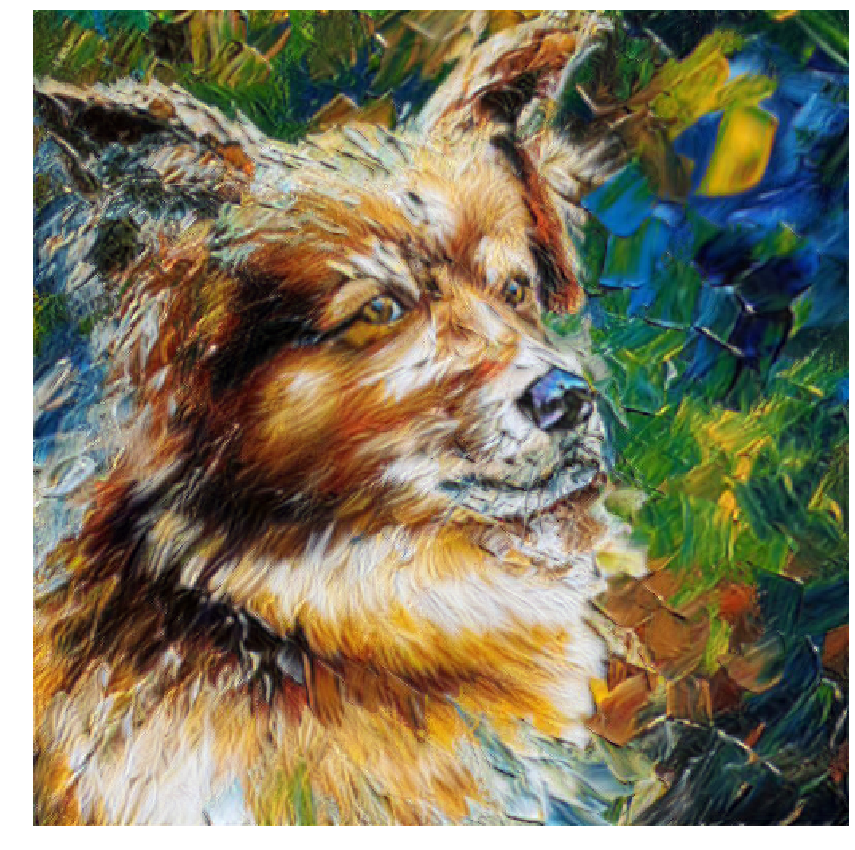

In [38]:
Image(img_hr).show(figsize=(18,15))

In [67]:
test_image = open_image('/home/jupyter/dog-oil-paintings/derek_russell.jpg')

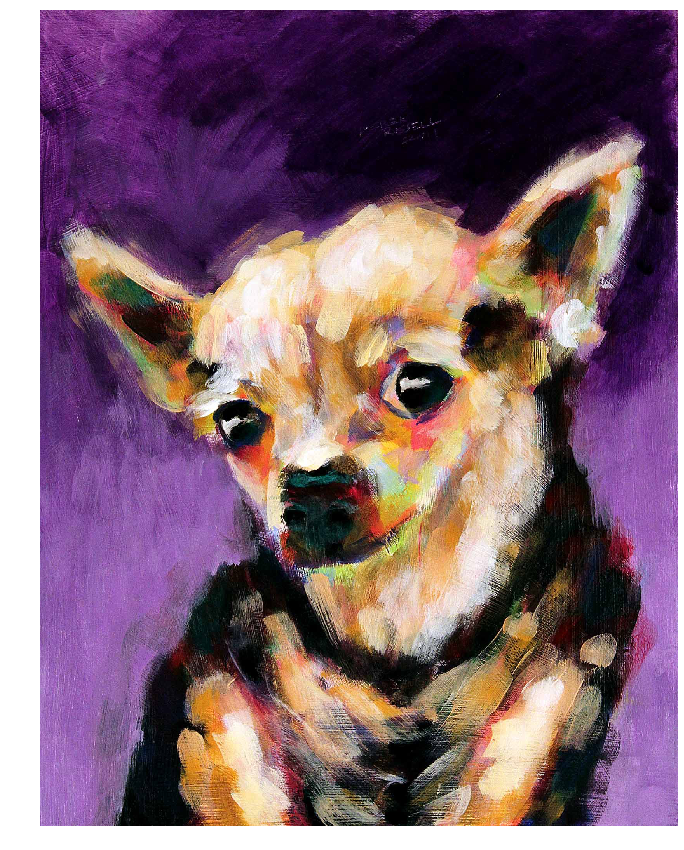

In [68]:
test_image.show(figsize=(18,15))

In [69]:
_,img_hr,b = learn.predict(test_image)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


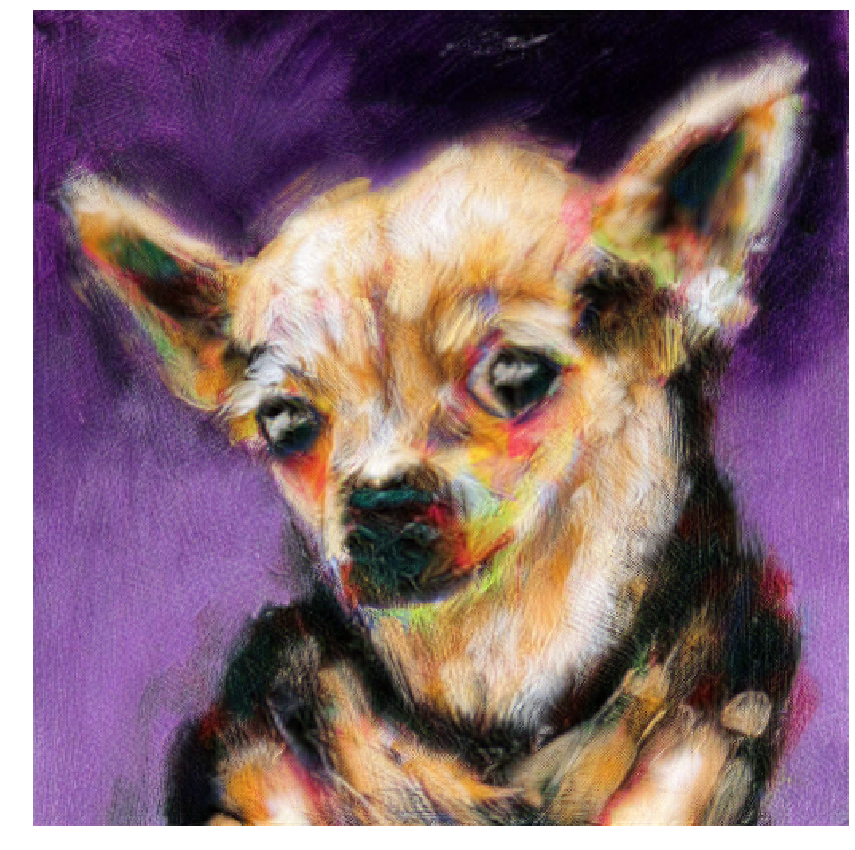

In [70]:
Image(img_hr).show(figsize=(18,15))

In [39]:
test_image = open_image('/home/jupyter/dog-oil-paintings/edwin_landseer1.jpg')

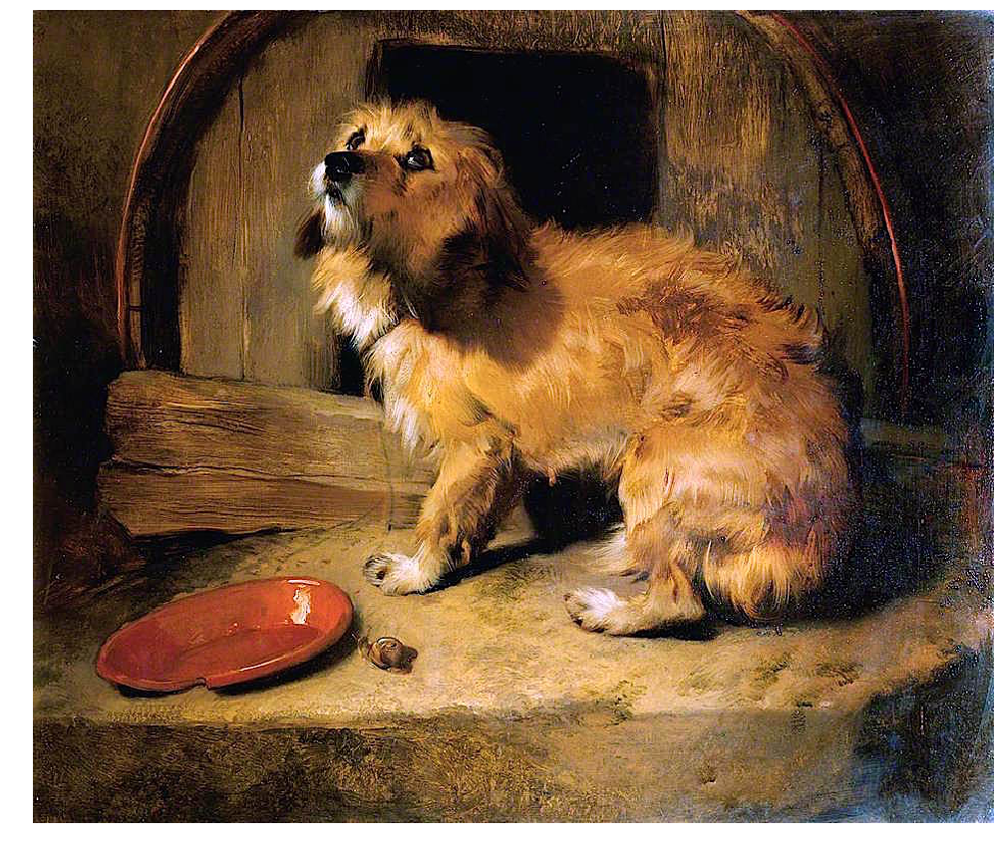

In [40]:
test_image.show(figsize=(18,15))

In [41]:
_,img_hr,b = learn.predict(test_image)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


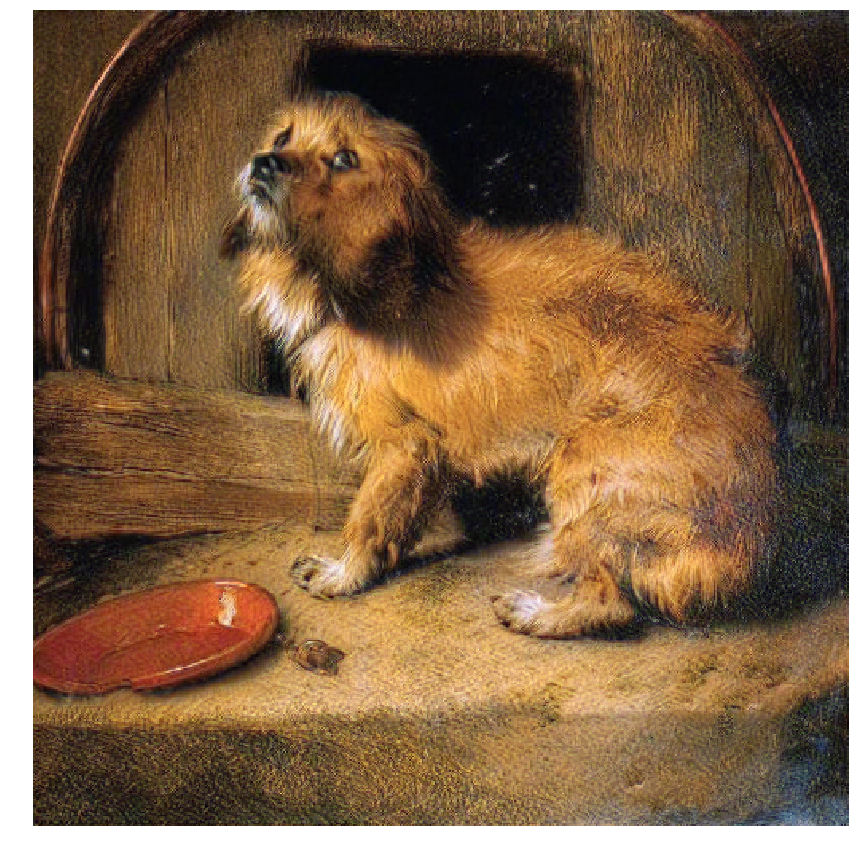

In [42]:
Image(img_hr).show(figsize=(18,15))

In [43]:
test_image = open_image('/home/jupyter/dog-oil-paintings/john_emms.jpg')

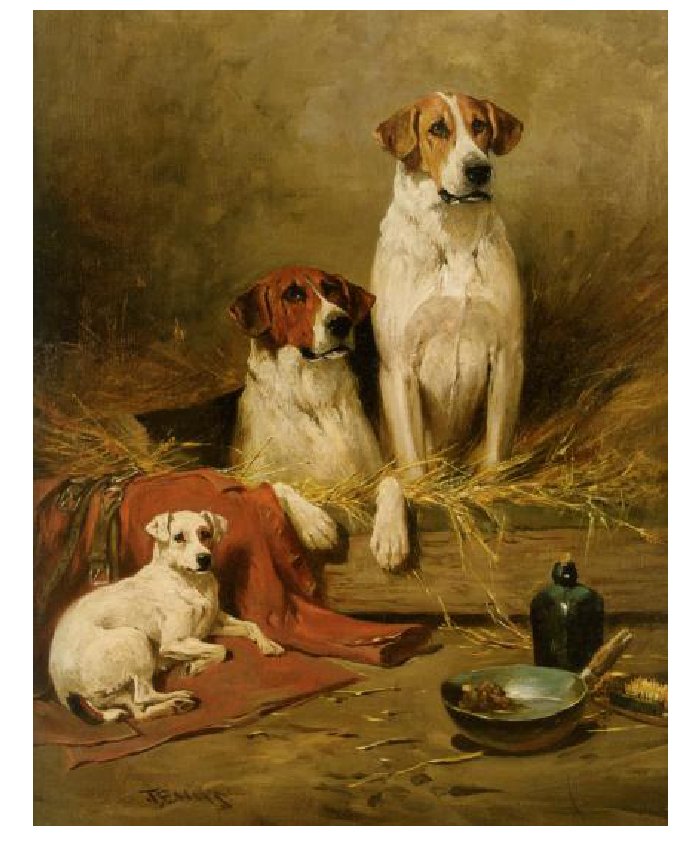

In [44]:
test_image.show(figsize=(18,15))

In [45]:
_,img_hr,b = learn.predict(test_image)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


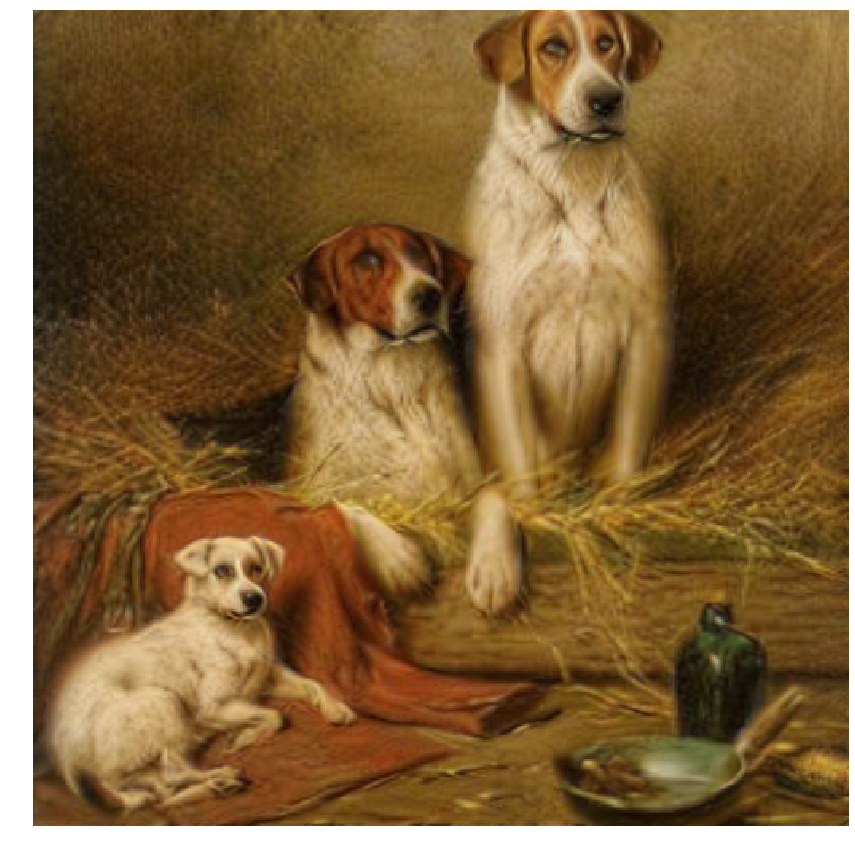

In [46]:
Image(img_hr).show(figsize=(18,15))

In [75]:
test_image = open_image('/home/jupyter/dog-oil-paintings/retriever.jpg')

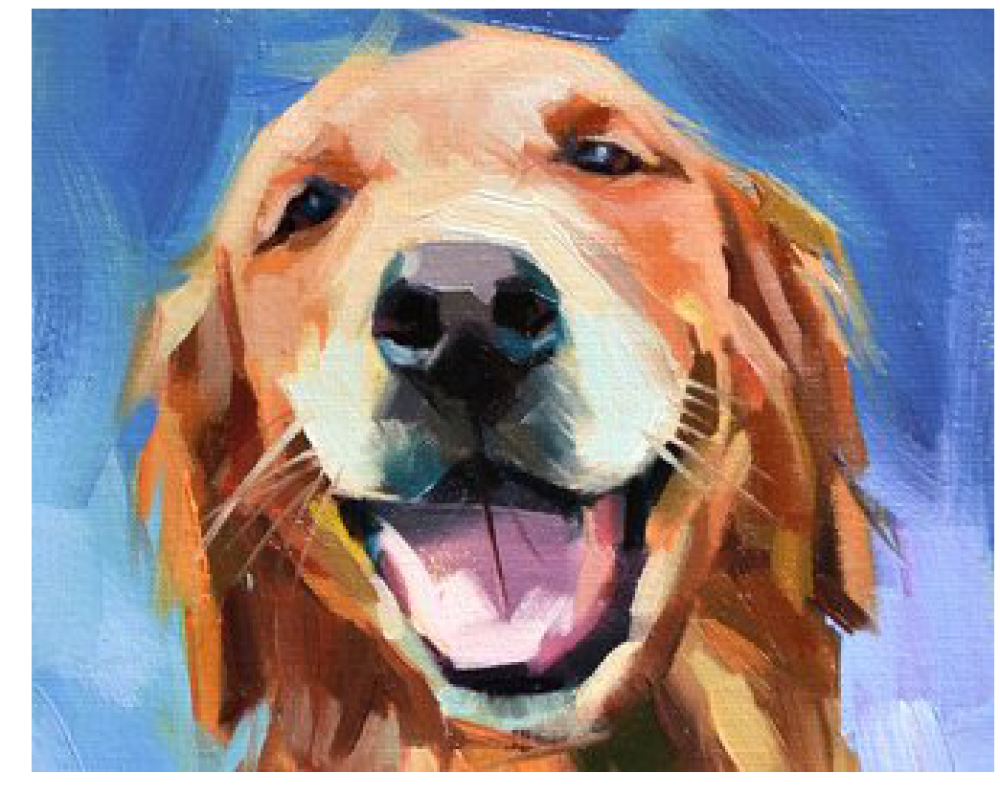

In [76]:
test_image.show(figsize=(18,15))

In [77]:
_,img_hr,b = learn.predict(test_image)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


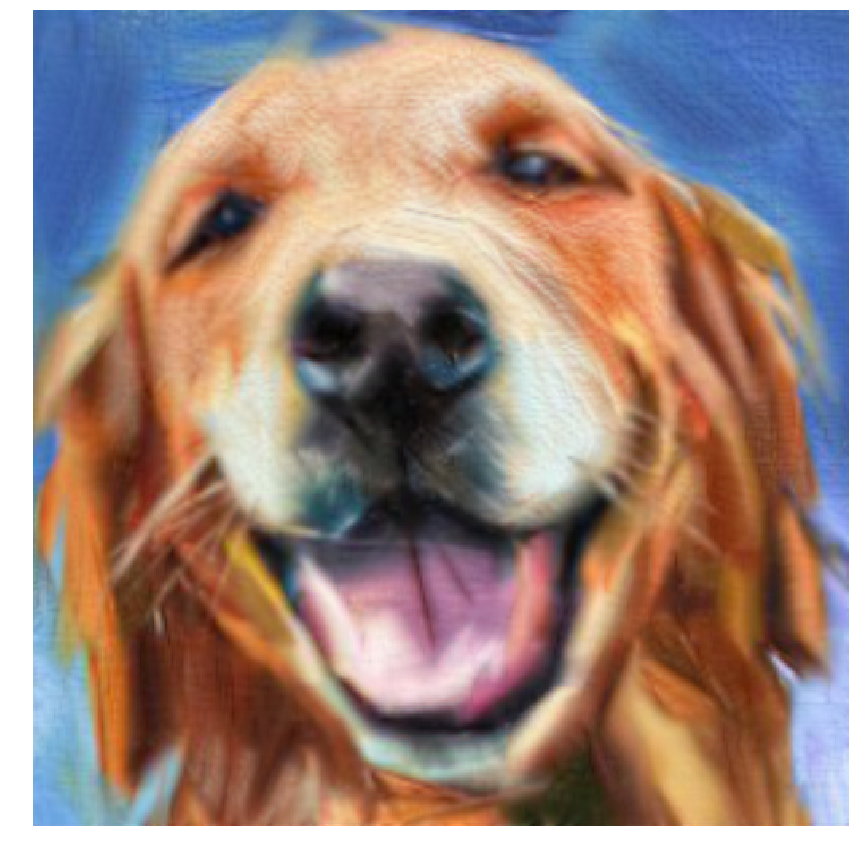

In [78]:
Image(img_hr).show(figsize=(18,15))

In [51]:
test_image = open_image('/home/jupyter/dog-oil-paintings/thomas_gainsborough1.jpg')

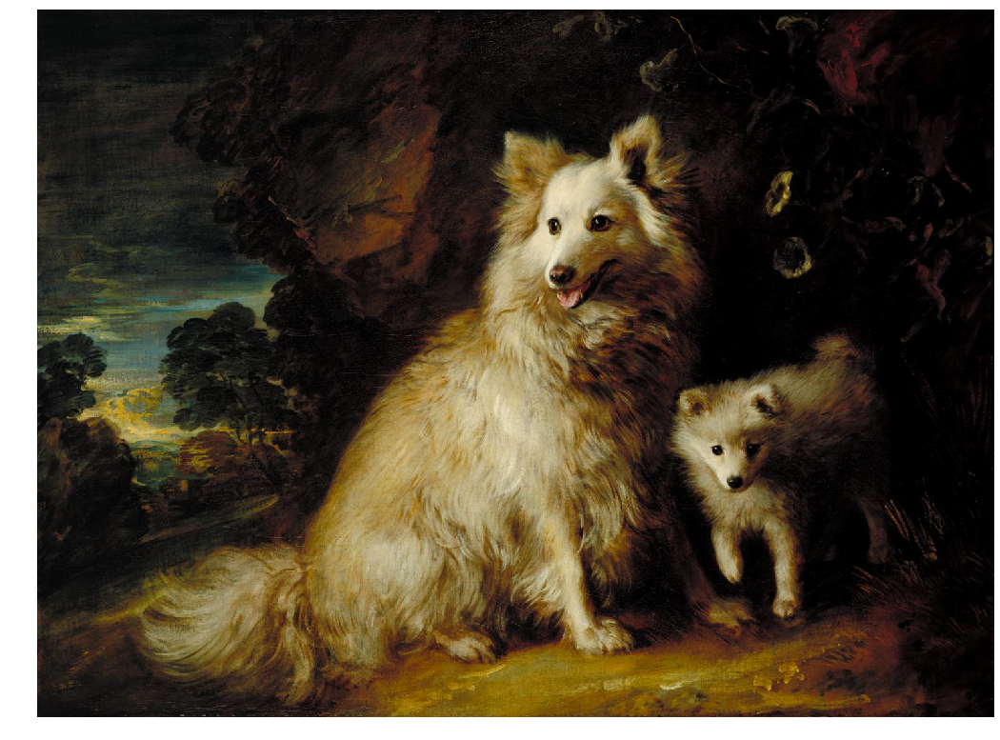

In [52]:
test_image.show(figsize=(18,15))

In [53]:
_,img_hr,b = learn.predict(test_image)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


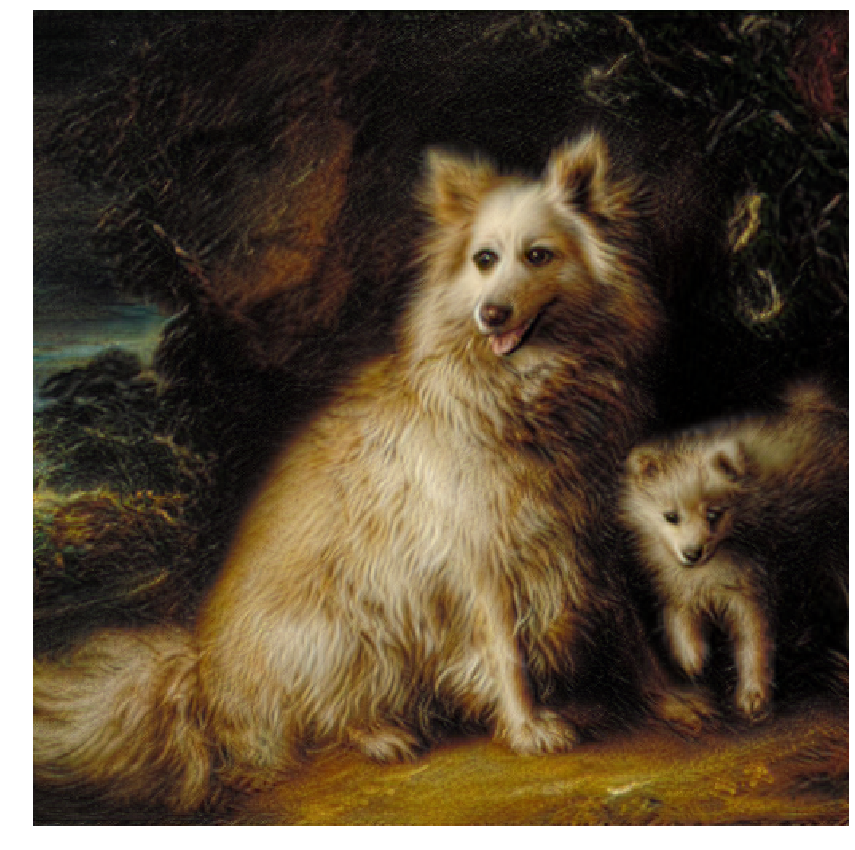

In [54]:
Image(img_hr).show(figsize=(18,15))

In [55]:
test_image = open_image('/home/jupyter/dog-oil-paintings/1planq.jpeg')

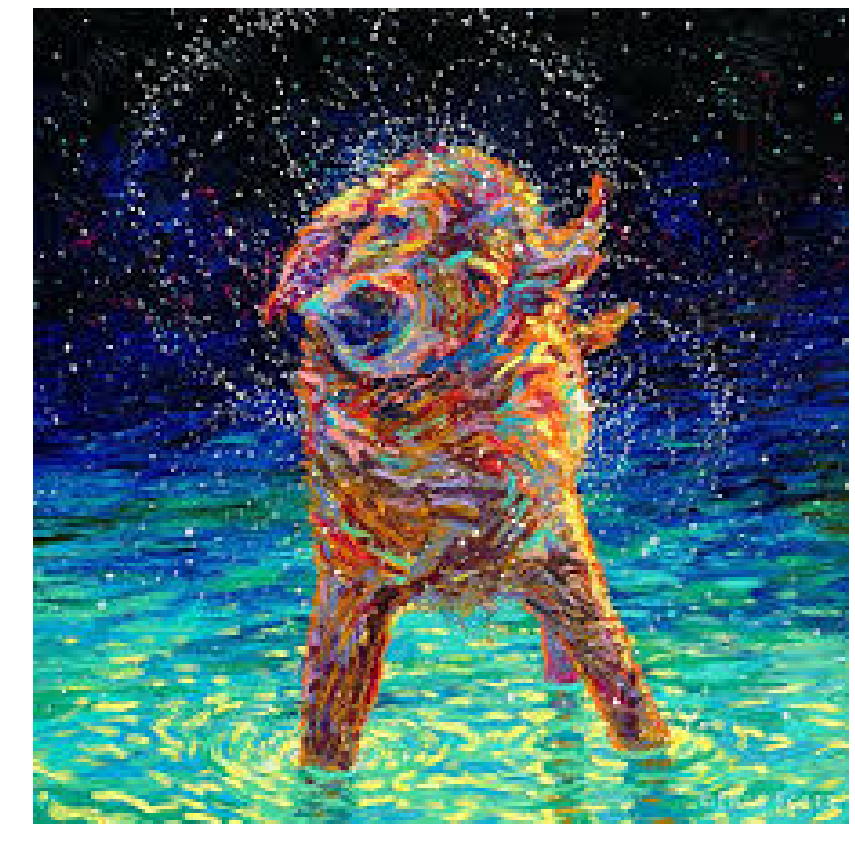

In [56]:
test_image.show(figsize=(18,15))

In [57]:
_,img_hr,b = learn.predict(test_image)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


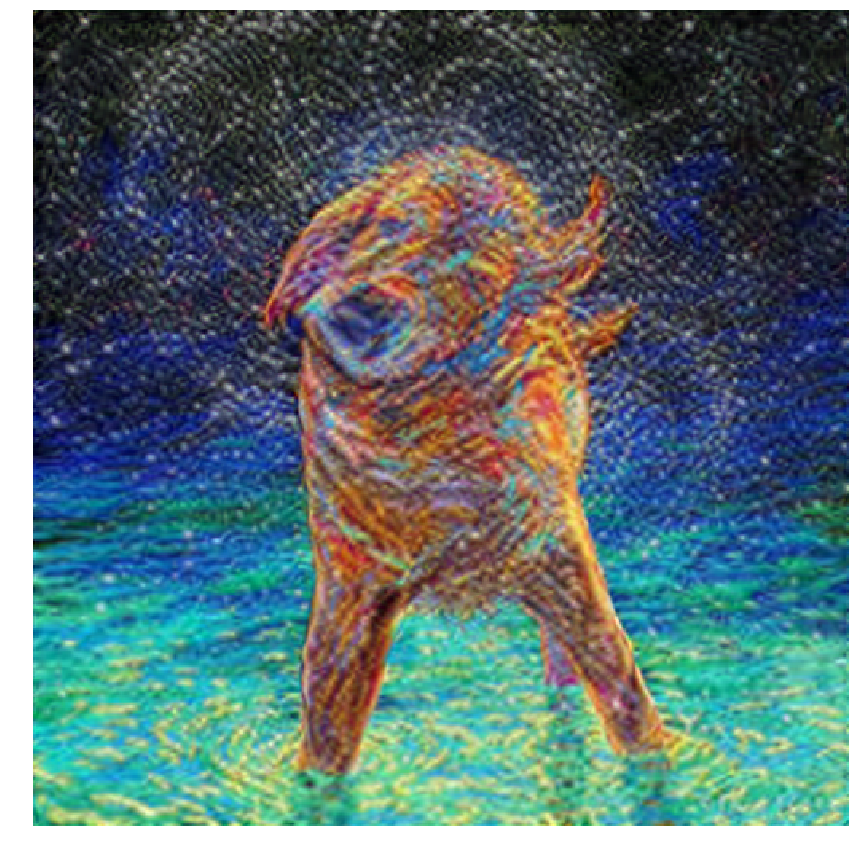

In [58]:
Image(img_hr).show(figsize=(18,15))